# MTH3302: Méthodes probabilistes et statistiques pour l'I.A.
## Projet

- Vincent Haney
- Félix Pelletier
- Charles-François St-Cyr (275354)
- Mikael Vaillant (2029994)


### 1. Librairies

In [1808]:
using CSV, DataFrames, Distributions, Gadfly, MLBase, Random, Statistics, Colors, GLM, LinearAlgebra, Combinatorics, CategoricalArrays,Distances,NearestNeighbors

include("./library/main.jl");
include("./library/normalize.jl");
include("./library/missing-values.jl");

### 2. Visualisation des données

#### 2.1. Chargement des données pour la visualisation

In [1809]:
base_data = CSV.read("./data/train_light.csv", DataFrame);

first(base_data, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67
4,4,Ideal,G,VS2,61.7,57.0,720,4.41,4.38,2.71
5,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02


#### 2.2. Visualisation de la taille

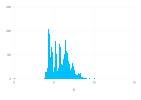

In [1810]:
plot(base_data, x = :x, Geom.histogram)

#### 2.3. Comparaison des valeurs de tailles ($X$, $Y$, $Z$)

Nous examinons la relation entre $X$, $Y$ et $Z$. À première vue, ces données sont fortement corrélées. Ainsi, notre modèle ne devrait comporter qu'une seule de ces variables.

Nous remarquons également qu'il y a plusieurs points de données qui semblent aberrants.

In [1811]:
plot(stack(base_data, [:y, :z]), x = :x, y = :value, color=:variable, Geom.point)

#### 2.4. Comparaison de $table$ et $depth$

On remarque que ces deux variables ne sont pas totalement indépendante. Les valeurs de $depth$ semblent diminuer un peu avec les valeurs de $table$ qui augmente. Cependant, cette corélation semble plutôt faible et il y a de l'information à en retirer de ces deux variables.

In [1812]:
plot(base_data, x = :table, y = :depth)

#### 2.5. Comparaison de $X$, $Y$ et $Z$ par rapport au coût

On remarque que les valeurs de tailles sont corrélé avec le prix. On remarque que la taille augmente lorsque $price$ augmente.

On remarque aussi que $X$ et $Y$ pourrait être presque égaux pour chaque point de donné. C'est la tendence qui semble être observé lorsqu'on regarde les données numériques et selon le contexte.

On remarque aussi qu'il y a quelques données abberantes, dont des données de tailles égales à $0$.

In [1813]:
plot(stack(base_data, [:x, :y, :z]), x = :price, y = :value, color = :variable)

#### 2.6. Comparaison de $table$ et $depth$ par rapport au coût

À première vue, ces variables ne semblent pas être les meilleures variables explicative.

In [1814]:
plot(stack(base_data, [:table, :depth]), x = :price, y = :value, color = :variable)

### 3. Chargement des données

In [1815]:
base_data = CSV.read("./data/train.csv", DataFrame);
base_test = CSV.read("./data/test.csv", DataFrame);

base_train, base_valid = partitionData(data, 0.75);

### 4. Détection de la colinéarité

Dans la section 2, nous avons remarqué qu'il y a très probablement de la colinéarité dans nos variables explicatives. Nous allons donc utiliser le VIF. Le VIF pour une variable $A$ est défini par :

$$
VIF_A = \frac{1}{1 - R^2_A}
$$

Où $R^2_A$ est le $R^2$ obtenu en faisant une régression linéaire de $A$ selon les autres variables explicatives. Une variable est considéré colinéaire si $VIF > 10$.

Tel qu'attendu, les variables $X$, $Y$ et $Z$ sont colinéaire. On remarque aussi que $depth$ et certaines $clarity$ sont aussi colinéaire.

In [1816]:
data = deepcopy(base_data)

convertQualitativeToQuantitative(data, :color)
convertQualitativeToQuantitative(data, :cut)
convertQualitativeToQuantitative(data, :clarity)

color_names = getNamesForQuantitative(data, :color)
cut_names = getNamesForQuantitative(data, :cut)
clarity_names = getNamesForQuantitative(data, :clarity)

sort!(
    getAllVIF(data, ["x", "y", "z", "table", "depth", color_names..., cut_names..., clarity_names...]),
    :VIF,
    rev = true,
)

Row,Variable,VIF
,String,Float64
1,z,371.347
2,x,251.472
3,y,31.8934
4,clarity: SI1,13.9398
5,clarity: VS2,13.6598
6,depth,11.2673
7,clarity: SI2,10.9516
8,cut: Ideal,10.6833
9,clarity: VS1,10.2335


### 5. Valeurs manquantes

Vérifions dans les données quels sont les valeurs manquantes.

#### 5.1 Chargement des données

In [1817]:
data = deepcopy(base_data);
test = deepcopy(base_test);

#### 5.2 Vérification des données

##### 5.2.1 Data

In [1818]:
data_missing_counts = collect(count(ismissing, col) for col in eachcol(data))
data_zero_counts = (hcat([0,0,0,0]',hcat([count(x -> x < 0.05, skipmissing(data[:, col])) for col in [:depth,:table,:price,:x, :y, :z]]...)))'[:, 1]

DataFrame(Variables = names(data), DataMissing = data_missing_counts, DataZero = data_zero_counts)

Row,Variables,DataMissing,DataZero
,String,Int64,Int64
1,ID,0,0
2,cut,3806,0
3,color,0,0
4,clarity,0,0
5,depth,2201,13
6,table,0,0
7,price,0,0
8,x,0,4
9,y,2200,3


#### 5.2.2 Test

In [1819]:

test_missing_counts = collect(count(ismissing, col) for col in eachcol(test))
test_zero_counts = (hcat([0,0,0,0]',hcat([count(x -> x < 0.05, skipmissing(test[:, col])) for col in [:depth,:table,:x, :y, :z]]...)))'[:, 1]

DataFrame(Variables = names(test), DataMissing = test_missing_counts, DataZero = test_zero_counts)

Row,Variables,DataMissing,DataZero
,String,Int64,Int64
1,ID,0,0
2,cut,1194,0
3,color,0,0
4,clarity,0,0
5,depth,800,5
6,table,0,0
7,x,0,4
8,y,800,4
9,z,0,5


### 6. **Méthode 1** : Régression linéaire simple

La première étape sera de faire une régression linéaire simple. Les données manquantes seront remplacé naïvement. Cette méthode ne soit pas idéale puisque qu'elle n'a pas une bonne estimation des valeurs manquantes. Cependant, cette méthode nous donne un $RMSE$ qu'on peut utiliser comme "*benchmark*" pour la suite.

#### 6.1 Chargement des données

In [1820]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 6.2 Traitement des valeurs manquantes

On remarque qu'il y a des valeurs manquantes dans les colonnes $cut$, $depth$ et $y$.

Tel qu'observé, on sait que les valeurs de $x$ sont très semblables aux valeurs de $y$, ainsi, nous allons remplacer toutes les valeurs manquantes de $y$ pas sa valeur de $x$.

Pour $cut$, nous allons remplacer les valeurs manquantes par le mode.

Pour $depth$, nous connaissons la formule pour l'obtenir, soit $2\times\frac{z}{x+y}$. Puisque nous allons remplacer les valeurs manquantes de $y$, alors il sera possible de recalculer la valeur.

In [1821]:
replaceValuesNaive.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64
1,1,Ideal,E,SI2,60.2,60.0,5340,6.46,6.5,3.9
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67
4,5,Ideal,G,VS2,62.4,58.0,6301,6.41,6.48,4.02
5,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7


#### 6.3 Gestion de la colinéarité : Introduction d'une nouvelle variable

Nous savons que les variables $X$, $Y$ et $Z$ sont très colinéaire. Pour éviter ce problème, nous allons introduire la variable de volume. Puisqu'un élément important pour définir le prix d'un diamant est le nombre de carat (le poids), nous estimons que le volume est une bonne variable explicative. On défini donc

$$
volume = x \times y \times z
$$

In [1822]:
train[!, :volume] = train.x .* train.y .* train.z
valid[!, :volume] = valid.x .* valid.y .* valid.z
test[!, :volume] = test.x .* test.y .* test.z;

#### 6.4 Définition du modèle

In [1824]:
M = lm(@formula(price ~ volume + cut + clarity + color), train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

price ~ 1 + volume + cut + clarity + color

Coefficients:
───────────────────────────────────────────────────────────────────────────────
                     Coef.  Std. Error       t  Pr(>|t|)  Lower 95%   Upper 95%
───────────────────────────────────────────────────────────────────────────────
(Intercept)     -6229.03     96.5087    -64.54    <1e-99  -6418.19   -6039.86
volume             50.1963    0.129722  386.95    <1e-99     49.942     50.4505
cut: Good         421.236    65.2349      6.46    <1e-09    293.373    549.099
cut: Ideal        559.791    58.9577      9.49    <1e-20    444.231    675.35
cut: Premium      533.181    60.111       8.87    <1e-18    415.361    651.001
cut: Very Good    498.37     60.6598      8.22    <1e-15    379.475    617.266
clarity: IF      4841.98     96.7384     50.05    

#### 6.5 Validation du modèle

Avec ce modèle, nous obtenons généralement un RMSE entre $1200$ et $1250$.

In [1825]:
θ̂ = predict(M, valid)
rmse = RMSE(θ̂, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 1238.0


### 7. **Méthode 2** : Régression linéaire avec estimation des valeurs manquantes par régression

À la première étape, nous avons utilisés des méthodes plus naïve pour estimer nos valeurs manquantes. Pour améliorer notre estimation, nous allons donc améliorer notre stratégie pour estimer les valeurs manquantes.

Cependant, nous garderons la même stratégie pour estimer $depth$.

#### 7.1 Chargement des données

In [1826]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 7.2 Transformation de la variable cut

Puisque la variable cut est qualitative, on ne peut pas utiliser un modèle linéaire pour l'estimer directement. Nous allons donc transformer la variable pour l'avoir de façon quantitative selon ce tableau.

| Valeur        | cut: Good | cut: Ideal | cut: Premium | cut: Very Good |
| ------------- | --------- | ---------- | ------------ | -------------- |
| $Fair$        | $0$       | $0$        | $0$          | $0$            |
| $Good$        | $1$       | $0$        | $0$          | $0$            |
| $Ideal$       | $0$       | $1$        | $0$          | $0$            |
| $Premium$     | $0$       | $0$        | $1$          | $0$            |
| $Very$ $Good$ | $0$       | $0$        | $0$          | $1$            |

In [1827]:
convertQualitativeToQuantitative.([train, valid, test], :cut)

cut_names = getNamesForQuantitative(train, :cut)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64?,Int64?,Int64?,Int64?
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9,missing,missing,missing,missing
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0
4,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,missing,missing,missing,missing
5,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,1,0


#### 7.3 Traitement des valeurs manquantes

Pour la variable $y$, nous définissons un modèle $y ~ x + table$, ensuite nous remplaçons les valeurs manquantes par la prédiction du modèle.

La variable $depth$ est traité de la même manière qu'à la section 6.2, soit que la valeur est recalculé avec $x$, $y$ et $z$.

Pour la variable $cut$, on défini $n - 1$ modèle pour chaque valeur. Ensuite, lorsque $cut$ est manquant, on remplace les valeurs quantitatives par l'estimation.

In [1828]:
replaceValuesRegression.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64,Real,Real,Real,Real
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9,0.12312,0.262919,0.310153,0.261519
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0
4,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,0.0670841,0.394744,0.31072,0.202198
5,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,1,0


#### 7.4 Gestion de la colinéarité : Introduction d'une nouvelle variable
Tout comme à l'étape précédente, nous allons introduire la variable :

$$
volume = x \times y \times z
$$

In [1829]:
train[!, :volume] = train.x .* train.y .* train.z
valid[!, :volume] = valid.x .* valid.y .* valid.z
test[!, :volume] = test.x .* test.y .* test.z;

#### 7.5 Définition du modèle

In [1830]:
M = lm(term(:price) ~ term(:volume) + term(:clarity) + term(:color) + sum(term.(cut_names)), train)

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

price ~ 1 + volume + clarity + color + cut: Good + cut: Ideal + cut: Premium + cut: Very Good

Coefficients:
────────────────────────────────────────────────────────────────────────────────
                     Coef.  Std. Error       t  Pr(>|t|)   Lower 95%   Upper 95%
────────────────────────────────────────────────────────────────────────────────
(Intercept)     -6210.63     96.0392    -64.67    <1e-99  -6398.87    -6022.38
volume             50.1995    0.129953  386.29    <1e-99     49.9448     50.4542
clarity: IF      4833.5      97.0458     49.81    <1e-99   4643.28     5023.71
clarity: SI1     3263.73     83.1974     39.23    <1e-99   3100.66     3426.8
clarity: SI2     2471.4      83.508      29.59    <1e-99   2307.72     2635.08
clarity: VS1     4096.86     84.8474     48.28    <1e-99   3930.55     42

#### 7.6 Validation du modèle

Avec ce modèle, nous obtenons le même RMSE. La régression pour obtenir les données manquantes ne semblent pas apporter une différence significative.

In [1831]:
θ̂ = predict(M, valid)
rmse = RMSE(θ̂, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 1238.0


### 8. **Méthode 3** : Analyse en composantes principales

La méthode 2 n'a pas apporté d'amélioration par rapport à la méthode 1. Nous devons donc utiliser une différente méthode. Dans la méthode 1 nous avons introduit la variable $volume$ afin de tenter  de contourner le problème de colinéarité. Cependant, cette technique n'est pas idéale puisqu'elle enlève de l'information sur les valeurs individuelles de $x$, $y$ et $z$ et qu'elle ne prends pas en compte la colinéarité observé sur les variables $depth$ et $clarity$.

L'analyse en composante principale est une excellente méthode pour remédier à cette problématique.

#### 8.1. Chargement des données

In [1832]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 8.2. Transformation des valeurs qualitatives

In [1833]:
convertQualitativeToQuantitative.([train, valid, test], :cut)
convertQualitativeToQuantitative.([train, valid, test], :color)
convertQualitativeToQuantitative.([train, valid, test], :clarity)

cut_names = getNamesForQuantitative(train, :cut)
color_names = getNamesForQuantitative(train, :color)
clarity_names = getNamesForQuantitative(train, :clarity)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64?,Int64?,Int64?,Int64?,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9,missing,missing,missing,missing,1,0,0,0,0,0,0,0,1,0,0,0,0
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0
4,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,missing,missing,missing,missing,0,0,1,0,0,0,0,0,0,0,1,0,0
5,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1


#### 8.3. Traitement des valeurs manquantes

Les valeurs manquantes sont traité de la même manière qu'à la section 7.3, soit en faisant une régression sur les variables manquantes.

In [1834]:
replaceValuesRegression.([train, valid, test])

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,cut: Good,cut: Ideal,cut: Premium,cut: Very Good,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64,Real,Real,Real,Real,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9,0.12312,0.262919,0.310153,0.261519,1,0,0,0,0,0,0,0,1,0,0,0,0
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0
4,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,0.0670841,0.394744,0.31072,0.202198,0,0,1,0,0,0,0,0,0,0,1,0,0
5,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1


#### 8.3. Définition des matrices

$X$: Matrice de données d'entrainement

$Z$: Matrice normalisée de données d'entrainement

$y$: Vecteur des prédictions pour l'entrainement

In [1835]:
cols = ["table", "depth", "x", "y", "z", cut_names..., color_names..., clarity_names...]

function standardize(df::DataFrame)
    for col in names(df)
        df[!, col] = (df[!, col] .- mean(df[!, col])) ./ std(df[!, col])
    end
    
    return df
end;

X = select(train, cols)

y = train.price
Z = hcat(ones(nrow(train)), Matrix(standardize(X)))

30341×23 Matrix{Float64}:
 1.0   1.14224   -0.817563   0.64881   …  -0.540959  -0.270728  -0.322659
 1.0  -0.199762   0.515586  -0.54449      -0.540959  -0.270728   3.09915
 1.0   0.694908   0.142304  -1.248        -0.540959   3.69363   -0.322659
 1.0   0.247573   0.355608   0.604284      1.84851   -0.270728  -0.322659
 1.0   1.14224   -0.124326  -1.22129      -0.540959  -0.270728   3.09915
 1.0   1.58958   -0.817563  -1.19457   …  -0.540959  -0.270728  -0.322659
 1.0   0.694908   1.42213   -0.384196     -0.540959  -0.270728  -0.322659
 1.0  -0.199762   0.302282   0.764578     -0.540959  -0.270728  -0.322659
 1.0   0.694908  -0.870889   0.132307     -0.540959  -0.270728  -0.322659
 1.0   0.694908  -1.45747    0.141212      1.84851   -0.270728  -0.322659
 ⋮                                     ⋱   ⋮                    
 1.0  -0.647097  -1.03087   -0.606826     -0.540959  -0.270728  -0.322659
 1.0  -0.647097   0.248956  -0.455438     -0.540959  -0.270728  -0.322659
 1.0  -0.199762   0.355

#### 8.4. Décomposition de la matrice $Z$

In [1836]:
U, S, V = svd(Z);

#### 8.5. Variance expliquée par les composantes principales

Ici, l'objectif est de déterminer combien de variables sont nécessaire pour notre estimation. On remarque que pour avoir près de 100%, il est nécessaire d'utiliser 18 sur 23 variables explicatives.

Par soucis de simplicité, nous allons simplement garder les 23 variables puisqu'il n'y en a pas beaucoup de superflues.

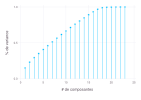

In [1837]:
v = cumsum(S.^2) / sum(S.^2)

plot(x=1:length(v), y=v, Geom.point, Geom.hair,
    Guide.xlabel("# de composantes"), 
    Guide.ylabel("% de variance"))

#### 8.6. Calcul de la matrice des composantes principales

In [1838]:
T = Z * V;

#### 8.7. Vérification de la colinéarité

Puisque l'objectif de cette technique est de ne pas avoir de multicolinéarité, alors on peut calculer les VIF pour s'en assurer. Ici, on voit que les VIF sont tous à $1$, on peut donc confirmer qu'il n'y a aucune colinéarité puisque les composantes sont orthogonales.

In [1839]:
getAllVIF(DataFrame(T, :auto))

Row,Variable,VIF
,String,Float64
1,x1,1.0
2,x2,1.0
3,x3,1.0
4,x4,1.0
5,x5,1.0
6,x6,1.0
7,x7,1.0
8,x8,1.0
9,x9,1.0


#### 8.8. Régression sur l'analyse en composantes principales

Nous allons utiliser notre vecteur $y$ afin de créer notre estimation des facteur de régression.

In [1840]:
η̂ = T \ y

β̂ = V * η̂;

#### 8.9. Validation du modèle

Avec cette méthode, le RMSE est plus gros qu'aux étapes précédentes. Elle n'est donc pas concluante.

In [1841]:
Ỹ = hcat(ones(nrow(valid)), standardize(Matrix(select(valid, cols))))

ŷ = Ỹ * β̂
rmse = RMSE(ŷ, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 1580.0


### 9. **Méthode 4** : KNN simple

Des 3 méthodes précédentes, nous n'avons pas réussi à avoir des meilleurs résultats qu'avec la régression linéaire simple. Nous avons donc décidé d'explorer une nouvelle avenue : KNN. Notre théorie est qu'il existe une quantité limité de type de diamant vendu et qu'ils se répètent. D'ailleur, lorsqu'on visualise la taille, on remarque qu'il y a des pics et qu'il semble donc y avoir des catégories de taille.

Ainsi, nous pensons que pour les diamants dans le fichier de test, nous allons être capable de trouver des diamants semblables et estimer son prix avec la moyenne.

#### 9.1. Chargement des données

In [1842]:
data = deepcopy(base_data);
test = deepcopy(base_test);
train = deepcopy(base_train);
valid = deepcopy(base_valid);

#### 9.2. Transformation des valeurs qualitatives

Ici, les valeurs de $cut$ ne sont pas considérés puisqu'elles nuisent au modèle.

In [1843]:
convertQualitativeToQuantitative.([train, valid, test], :color)
convertQualitativeToQuantitative.([train, valid, test], :clarity)

color_names = getNamesForQuantitative(train, :color)
clarity_names = getNamesForQuantitative(train, :clarity)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64?,Float64,Int64,Float64,Float64?,Float64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9,1,0,0,0,0,0,0,0,1,0,0,0,0
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,0,1,0,0,0,0,0,0,0,0,0,1
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,1,0,0,0,0,0,0,0,0,0,0,1,0
4,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,0,0,1,0,0,0,0,0,0,0,1,0,0
5,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,0,0,0,0,0,0,0,0,0,0,1


#### 9.3. Traitement des valeurs manquantes

In [1844]:
replaceValuesRegression.([train, valid, test], ignoreCut = true)

first(train, 5)

Row,ID,cut,color,clarity,depth,table,price,x,y,z,color: E,color: F,color: G,color: H,color: I,color: J,clarity: IF,clarity: SI1,clarity: SI2,clarity: VS1,clarity: VS2,clarity: VVS1,clarity: VVS2
,Int64,String15?,String1,String7,Float64,Float64,Int64,Float64,Float64,Float64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,1,missing,E,SI2,60.2,60.0,5340,6.46,6.5,3.9,1,0,0,0,0,0,0,0,1,0,0,0,0
2,2,Ideal,G,VVS2,62.7,57.0,1936,5.12,5.05,3.19,0,0,1,0,0,0,0,0,0,0,0,0,1
3,3,Premium,E,VVS1,62.0,59.0,1012,4.33,4.28,2.67,1,0,0,0,0,0,0,0,0,0,0,1,0
4,5,missing,G,VS2,62.4,58.0,6301,6.41,6.48,4.02,0,0,1,0,0,0,0,0,0,0,1,0,0
5,6,Premium,D,VVS2,61.5,60.0,925,4.36,4.42,2.7,0,0,0,0,0,0,0,0,0,0,0,0,1


#### 9.4. Manipulation des données

Pour chaque ensemble, on ne garde que les variables quantitative qui nous intéresse. On ignore $cut$, $table$ et $depth$ puisqu'ils nuisent au modèle.

In [1845]:
Mat_train = Matrix(
    standardize(
        select(
            train,
            Not(["price","cut","ID","color","clarity","depth","table"]),
        )
    )
)';

Mat_valid = Matrix(
    standardize(
        select(
            valid,
            Not(["price","cut","ID","color","clarity","depth","table"]),
        )
    )
)';

Mat_test = Matrix(
    standardize(
        select(
            test,
            Not(["cut","ID","color","clarity","depth","table"]),
        )
    )
)';

#### 9.5. Définition de l'arbre KNN

In [1846]:
# Génération de l'arbre de données et ajout de poids pour les différentes variables
weight = zeros(size(Mat_train,1))

weight[1:3]   .= 1; # x, y, z
weight[4:9]   .= 1; # color
weight[10:16] .= 1; # clarity

kdtree = KDTree(Mat_train, WeightedEuclidean(weight));

#### 9.6. Validation du modèle

Avec ce modèle, nous obtenons un RMSE significativement meilleur. Nous allons donc utiliser ce modèle pour faire nos prédictions.

In [1847]:
# Nombre de plus proches voisins à utiliser
k = 5

# Algo knn pour valid
idxs, dists = knn(kdtree, Mat_valid, k, true)

prediction = [
    dot(train.price[idxs[i]], dists[i]) / sum(dists[i])
    for i in 1:size(idxs, 1)
]

rmse = RMSE(prediction, valid.price)

println("RMSE: $(round(rmse))")

RMSE: 653.0


#### 9.7. Prédictions

In [1848]:
# Nombre de plus proches voisins à utiliser
k = 5

# Algo knn pour valid
idxs, dists = knn(kdtree, Mat_test, k, true)

predictions = [
    dot(train.price[idxs[i]], dists[i]) / sum(dists[i])
    for i in 1:size(idxs, 1)
]

CSV.write("./results/predictions.csv", DataFrame(ID = test.ID, price = predictions));

### 10. Analyse

#### 10.1. Pistes ignorées

1. Nous avions pensé à regrouper certaines classes ensemble. Par exemple, pour la clarté, nous avions pensé, puisque certaines catégories sont colinéaire, que nous pourrions les regrouper. Cependant, lorsque nous avons décidé d'explorer l'analyse en composantes principales et KNN, nous nous sommes dit que ce n'étais pas nécessaire.

2. Lorsqu'on a fait un histograme avec la taille, nous avons remarqué qu'il semblait y avoir plusieurs pics de données. Nous avons estimé que c'est possible qu'il y aie des catégories de taille plutôt que des tailles spécifiques de diamant. Cependant, ça ne semblait pas nécessaire avec notre avenue final (KNN), donc nous n'avons pas continué avec cette idée. 

#### 10.2. À améliorer

1. Pour KNN, nous avons ignoré les variables $cut$, $table$ et $depth$. Cependant, pour la régression, la variables $cut$ était significative et contribuait au modèle. Il serait intéressant de comprendre pourquoi en KNN ce n'est pas le cas et si ça serait possible d'améliorer notre modèle en l'utilisant d'une autre manière.